# Trabajo Final de Máster
**Máster en Data Science For Business**

Sustentantes: 

- Maria Jesús Quirós 
- Jorge Luis Barquero Villagra

Tutor: 
Ramón Alberto Carrasco

# CRISP-DM

**Requisitos previos**

Para ejecutar el siguiente notebook se debe tener un ambiente de Python con las siguientes librerías instaladas.

Versión de Python 3.8.xx

- mysql-connector-python 8.4.0
- plotly 5.9.0
- mlxtend 0.23.1
- networkx 3.1 
- fbprophet 1.1.5
- openpyxl 3.0.10
- nbformat 5.9.2
- kaleido 0.2.1


**Instalación de paquetes**

In [1]:
# %pip install mysql-connector-python     
# %pip install plotly                     
# %pip install mlxtend            
# %pip install networkx 
# %pip install fbprophet
# %pip install openpyxl
# %pip install nbformat
# %pip install -U kaleido

**Imports**

In [2]:
# Imports para ejecución del notebook
import pandas as pd
import os as os
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np
import sqlite3
import plotly.io as pio
from mlxtend.frequent_patterns import association_rules
from mlxtend.frequent_patterns import apriori
from prophet import Prophet
from IPython.display import Image
from prophet.plot import plot_plotly, plot_components_plotly
import networkx as nx
import plotly.graph_objects as go
from sklearn.metrics import mean_squared_error

/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/holidays/__init__.py:32: FutureIncompatibilityWarning: 

This is a future version incompatibility warning from Python Holidays library v0.50
to inform you about an upcoming change in our API versioning strategy that may affect your
project's dependencies. Starting from version 1.0 onwards, we will be following a loose form of
Semantic Versioning (SemVer) to provide clearer communication regarding any potential breaking
changes.

This means that while we strive to maintain backward compatibility, there might be occasional
updates that introduce breaking changes to our API. To ensure the stability of your projects,
we highly recommend pinning the version of our API that you rely on. You can pin your current
holidays v0.x dependency (e.g., holidays==0.50) or limit it (e.g., holidays<1.0) in order to
avoid potentially unwanted upgrade to the version 1.0 when it's released (ETA 2024Q4 - 2025Q1).

If you ha

**Variables globales**

In [3]:
# Variable global para administrar el directorio actual
parent_dir = os.path.dirname(os.getcwd())

# Configuración para los renders de plotly
pio.renderers.default = 'notebook'

# Ubicación de base de datos
database_name = '/data/database/tfm_couriers.db'

# Exportar a PDF 
exportar_pdf = False

# Registrar en base de datos
salvar_en_bd = False

**Funciones reutilizables**

In [4]:
# Funciones reutilizables
def SalvarEnBD(table_name, data):
    if salvar_en_bd:
        conn = sqlite3.connect(parent_dir + database_name)
        # Convierte el DataFrame a una tabla SQL
        data.to_sql(table_name , conn, if_exists='replace', index=False)

# **Business Understanding** - listo

Un courier es una empresa o servicio especializado en la entrega rápida y eficiente de paquetes, documentos y otros tipos de envíos. A diferencia de los servicios postales tradicionales, los couriers suelen ofrecer una mayor velocidad, seguridad y confiabilidad en la entrega de sus envíos. Suelen caracterizarse porque sus servicios incluyen:

- Rapidez: Algunas empresas couriers pueden hacer entregas en el mismo día, al día siguiente o en un plazo muy corto, dependiendo de la urgencia del envío.
- Seguimiento: Los envíos por courier generalmente pueden ser rastreados en tiempo real, proporcionando información precisa sobre el estado y la ubicación del paquete.
- Seguridad: Los couriers a menudo ofrecen un manejo más cuidadoso de los envíos, con seguros y opciones de firma al recibir el paquete.
- Flexibilidad: Ofrecen una amplia gama de servicios, desde entregas locales y nacionales hasta envíos internacionales, adaptándose a las necesidades específicas de sus clientes.
- Servicio al cliente: Proporcionan atención personalizada y soluciones específicas para problemas o necesidades de envío.

Los couriers son utilizados tanto por particulares como por empresas que necesitan enviar documentos importantes, productos comprados en línea, muestras comerciales, y otros tipos de paquetes que requieren una entrega rápida y segura.

La empresa ExpediteX es una empresa dedicada a prestación de servicios logísticos de Courier y mensajería, que cuenta con 25 años de experiencia en el mercado. Sus servicios van desde la importación de productos en la modalidad de carga y paqueteo, distribución local y nacional a domicilio, hasta la asesoría para la importación y exportación, casillero internacional y asesoría de compras internacionales. 

Por otro lado, SwiftShip cuenta con experiencia de 19 años en el manejo y traslado de paquetes y encomiendas, se caracterizan por trabajar directamente, sea, desde el recibimiento hasta la entrega de las mercancías es manejada por la empresa directamente (sin intermediarios).

Adicionalmente cuentan con 207 sucursales y/o puntos de recepción a nivel internacional en 50 países diferentes, entre ellos Estados Unidos, Canadá, Panamá, República Dominicana, Guatemala, Venezuela, Argentina, Brasil, Chile, Colombia, Ecuador, Perú, Uruguay, España, Italia, Portugal, Alemania y el resto de la Comunidad Europea. 


Ambas empresas operan en un mercado muy competitivo, donde la eficiencia en la entrega, la cobertura geográfica y la calidad del servicio al cliente son factores clave para su éxito. Estas empresas ofrecen una variedad de servicios, que van desde la entrega de paquetes locales hasta el envío internacional, adaptándose a las necesidades de diferentes segmentos del mercado, como particulares y empresas.

La integración de tecnologías avanzadas, como el rastreo en tiempo real y la gestión automatizada de inventarios y compras juega un papel crucial en la optimización de los procesos logísticos, con lo que la incorporación de toma de la decisiones basadas en datos, tiene gran importancia en las empresas de courier, pues es crucial para optimizar sus operaciones, mejorar la satisfacción del cliente y aumentar la eficiencia en el manejo de envíos.


## Objetivo General - listo

Desarrollar mediante la metodología CRISP-DM un análisis de datos sobre los procesos de importación de las empresas SwiftShip y ExpediteX de courier en Costa Rica durante el período 2021-2023, para la optimización de sus operaciones y mejora de la toma de decisiones estratégicas. Utilizando técnicas avanzadas de análisis de datos y las herramientas disponibles, se espera obtener al menos cinco recomendaciones concretas y presentar los hallazgos en un informe detallado en el plazo de cuatro meses.

## Objetivos Específicos - listo

- Implementar un análisis de cesta (basket analysis) utilizando algoritmos de asociación para la identificación de los patrones más relevantes de compra y relaciones entre los productos adquiridos por los importadores que han utilizado los servicios de las empresas SwiftShip y ExpediteX de courier en Costa Rica. Utilizando los datos de transacciones de los últimos tres años, se espera la mejora en las estrategias de marketing y optimización del servicio. El análisis se lleva a cabo y los resultados se presentan en un informe detallado en un plazo de tres meses. 

- Realizar un análisis de tendencias de las mercancías importadas utilizando técnicas de análisis de series temporales, para la identificación de patrones significativos y cambios importantes en la demanda de diferentes tipos de mercancías a lo largo del tiempo. Esto permitirá la anticipación de las necesidades logísticas y ajustes de estrategias de importación para la mejora de la eficiencia operativa. Dicho análisis se completará en un plazo de seis meses.

- Diseñar un conjunto de tres variables ingenieriles específicas para la implementación en las empresas SwiftShip y ExpediteX, para la optimización de los procesos de importación bajo la modalidad courier. Utilizando técnicas de análisis de datos y conocimientos de la industria, se espera la mejora de la eficiencia y efectividad de dichos procesos. Este diseño y la implementación de un plan piloto se completarán en un plazo de cinco meses.

## Definiciones - listo

- **Aduana:** Unidad técnico-administrativa encargada de las gestiones aduaneras y del control de las entradas, la permanencia y la salida de las mercancías objeto del comercio internacional (Art. 13 LGA).

- **Agente aduanero:** Profesional auxiliar de la función pública aduanera autorizado por la DGA para actuar, en su carácter de persona natural en la presentación habitual de servicios a terceros, en los trámites, los regímenes y las operaciones aduaneras. (Art. 33, LGA)

- **Auxiliar de la Función Pública:**  Personas físicas o jurídicas, públicas o privadas, que participen habitualmente ante el Servicio Nacional de Aduanas (SNA), en nombre propio o de terceros. (Art. 28 LGA). 

- **Bultos:** Unidad utilizada para contener mercancías. Puede consistir en cajas, sacas, fardos, cilindros y demás formas de presentación de las mercancías, según su naturaleza (Ministerio de Hacienda, 2021). 

- **Código Sistema Arancelario Centroamericano (SAC):** El Arancel Centroamericano de Importación está constituido por el Sistema Arancelario Centroamericano (SAC) y los correspondientes Derechos Arancelarios a la Importación (DAI). El código numérico del SAC está representado por diez dígitos que identifican: los dos primeros, al capítulo; los dos siguientes, a la partida; el tercer par, a la subpartida; y los cuatro últimos, a los incisos arancelarios. La identificación de las mercancías se hará siempre con los diez dígitos de dicho código numérico. (Estrategia Aduanera, s.f.) 

- **Código Sistema Armonizado (SA):** El Sistema Armonizado (SA) es un código de clasificación de mercancías creado por la Organización Mundial de Aduanas (OMA) y está compuesto por 6 dígitos con aceptación en todo el mundo. Sirve para llevar un control en las mercancías de exportación e importación en cuanto a los impuestos internos, monitoreo de bienes, origen y materia constitutiva. 

- **Declarante:** El importador o consignatario, en el caso de la importación de mercancías. 

- **Depositario Aduanero:** Persona física o jurídica, pública o privada, auxiliar de la función pública aduanera autorizadas mediante concesión por la DGA, que custodian y conservan temporalmente y con suspensión del pago de tributos, mercancías objeto de comercio exterior, bajo la supervisión y el control de la autoridad aduanera. (Ministerio de Hacienda, 2021). 

- **Derechos Arancelarios a la Importación (DAI):**  Derechos Arancelarios a la Importación que son un porcentaje estipulado por tipo de mercancías y se calcula sobre el Valor Aduanero. 

- **Descripción o designación de la mercancía:** Precisa identificación de las características de ésta, sea de manera concreta, detallada, que singulariza de tal forma el objeto a clasificar que no deja duda alguna sobre su tipificación. (Quirós, 2024).

- **DUA:** Documento Único Aduanero, declaración realizada mediante transmisión electrónica de datos, mediante la cual se indica el régimen aduanero y la modalidad que deberá aplicarse a las mercancías (Ministerio de Hacienda, 2021). 

- **Empresa de entrega rápida (EER):** Personas físicas o jurídicas legalmente establecidas, autorizadas y registradas ante la DGA, cuyo giro o actividad principal es la prestación de servicios de transporte internacional expreso a terceros, de correspondencia, documentos y envíos de mercancías bajo la modalidad de entrega rápida. (Ministerio de Hacienda, 2021).

- **Envíos de entrega rápida:** Documentos y mercancías transportadas bajo sistemas de entrega rápida o courier, consignadas a terceros. (Ministerio de Hacienda, 2021).

- **Factura Comercial:**  Documento expedido conforme a los usos y las costumbres comerciales, justificativo de un contrato de compraventa de mercancías o servicios extendido por el vendedor a nombre y cargo del comprador.

- **Fecha:** Fecha en que fue aceptado el DUA por el Sistema de Tecnología de Información para el Control Aduanero (TICA) de Costa Rica.

- **Flete:** Monto de flete desde el origen, o sea desde el momento en que se elabora el conocimiento de embarque original y se inicia el servicio de transporte hasta el puerto o lugar de importación. (Ministerio de Hacienda, 2021).

- **Identificación (ID) Agente:** Cédula de identidad física u jurídica del Agente Aduanero. 

- **Identificación (ID) Declarante:** En el caso que nos ataque, el número de identificación de la empresa declarante ante el Ministerio de Hacienda.

- **Identificación (ID) Localización:** Número de identificación de la empresa donde está localizada la mercancía, en el caso de envíos de courier, suele referirse al Depositario Aduanero o Almacén fiscal. 

- **Importador:** Empresario o empresa que se dedica a comprar productos a clientes del exterior para luego venderlos en el mercado local o para consumo o uso propio. 

- **Impuesto sobre el Valor Agregado (IVA):** Según el artículo 1 de la Ley 9635, el impuesto sobre el valor agregado se establece en la venta de bienes y en la prestación de servicios, independientemente del medio por el que sean prestados, realizados en el territorio en Costa Rica.

- **Impuestos Selectivo de Consumo (SC):** Impuesto establecido sobre bienes y servicios específicos, por razones que dependen de cada Estado. Entre las razones más comunes para gravar un bien específico se encuentra, por ejemplo, el carácter indemnizatorio o el desincentivador que se pretende implementar sobre o por el consumo o realización de este. Así, es que las bebidas alcohólicas, el tabaco, y la marihuana

- **Impuestos:** Los Derechos o impuestos a la importación corresponden al monto de tributos que el fisco recauda debido al ingreso de una mercancía extranjera al comercio nacional. (Ministerio de Hacienda, 2024).

- **Ítem:** Línea del DUA donde se describe e indica la cantidad de las mercancías que se presentan para ser destinadas a un régimen aduanero determinado. 

- **Ley 6946:** Tarifa de Ley N°6946, de un 1% aplicable sobre el valor aduanero.

- **Localización:** véase Depositario Aduanero.

- **Medio o modo de transporte:** Nave, aeronave, vagón ferroviario, vehículo automotor, o cualquier otro medio utilizado para el transporte de personas o mercancías. (Ministerio de Hacienda, 2021)

- **Mercancía:** Objeto susceptible de ser apropiado y, por ende, importado o exportado, clasificado conforme al arancel de aduanas.

- **Modalidad:** Cada régimen aduanero contará con modalidades según detalle, por ejemplo, la importación puede ser modalidad importación definitiva, temporal, courier, entre otras. 

- **Modelo:** De las mercancías que se adquieren, por ejemplo en sitios web y se trasladan a Costa Rica, bajo la modalidad de courier.

- **Nota técnica:** requisitos no arancelarios o autorizaciones preestablecidos por la institución rectora mediante leyes y decretos, que avalan el ingreso o salida de las mercancías del o al territorio nacional. (Ministerio de Hacienda, 2021)

- **País de adquisición:** País en donde se adquirido el servicio o mercancía. 

- **País de origen:** País de donde, según lo establecido en el Tratado de Libre Comercio, son originarias las mercancías o servicios. 

- **País de procedencia:** País de donde procede la mercancía, que no necesariamente coincide con el país de origen o de adquisición. 

- **Peso bruto:** El peso bruto es el peso total de un producto más su empaque o contenedor.

- **Peso neto:** El peso neto de un producto, sea únicamente el peso del producto en sí. 

- **Precio FOB:** FOB es un término comercial que pertenece a los Incoterms, corresponde a las siglas en inglés de 'Free on board'. El Precio FOB se determina por: precio de la mercancía,  el precio de embalaje y etiquetado, precio por transporte desde la planta de producción hasta el puerto de origen, el precio del seguro de la mercancía durante su traslado a puerto, gastos administrativos generados por la concesión de permisos o licencias, gastos derivados de las autoridades aduaneras, algunos gastos bancarios resultantes de pagos y transferencias internacionales y gastos portuarios, como uso de muelle, elevadores o estiba.

- **PROCOMER:** Promotora de Comercio Exterior de Costa Rica, pago de $3 por cada declaración aduanera transmitida electrónicamente, para la institución. 

- **Proveedor:** Persona física o jurídica que suministra profesionalmente un determinado bien o servicio a otros individuos o sociedades, como forma de actividad económica y a cambio de una contra prestación.

- **Régimen:** Diferentes destinaciones a que pueden quedar sujetas las mercancías que se encuentran bajo control aduanero (Art 109. LGA)

- **Seguro:** Protección de la carga desde que sale del depósito del vendedor hasta las bodegas del comprador, o según INCOTERM.

- **Unidad de medida:** Referencia convencional que se usa para medir la magnitud física de un determinado objeto, sustancia o fenómeno. 

- **Valor CIF:** Representa el precio total de la mercancía, incluyendo el coste, del seguro y el flete hasta el puerto de destino acordado. 

- **Valor en Aduana:** El valor de transacción, o precio realmente pagado o por pagar por las mercancías cuando éstas se venden para su exportación al país de importación.

# **Data Understanding** -- listo

La fase de comprensión de datos de CRISP-DM implica estudiar de cerca los datos disponibles de minería. Este paso es esencial para evitar problemas inesperados durante la siguiente fase (preparación de datos) que suele ser la fase más larga de un proyecto.

Como se señala, el proceso de data understanding es importante para establecer una base sólida para el análisis, permitiendo una comprensión profunda de la estructura y el contenido de la base de datos, que incluye elementos como DUA, Fecha DUA, Código SAC, cantidad, Valor FOB USD$, Costo flete USD$, Costo seguro USD$, Valor CIF USD$, Valor en Aduana USD$, Peso bruto en libras, Descripción de Mercancía, Total IVA USD$, Total Ley 6946 USD$, total DAI US$, Total SC USD$ y total de Impuestos. 


Se parte de un enfoque en los tres objetivos específicos descritos con anterioridad.

## Carga de archivo de datos fuente -- listo

Se inicia con una carga del conjunto de datos, ubicado en la carpeta '/data/raw/' de nuestro directorio. Para evitar problemas de ubicación, se utiliza la variable parent_dir que representa el directorio padre de la solución. Esto se obtuvo al inicio de este notebook

In [5]:
# Lectura del archivo de datos y almacenamiento en variable data
data = pd.read_excel (parent_dir + '/data/raw/data.xlsx', sheet_name='UnifiedData')

# Se despliega los primeros registros de los datos
data.head()

,DUA,Item del DUA,Fecha DUA,Aduana,Regimen,Modalidad,Importador,Proveedor,Marca,Modelo,...,Total IVA USD,% Ley 6946,Total Ley 6946 USD,% DAI,Total DAI USD,COSTO por PROCOMER USD,% S.C,Total SC USD,Otros impuestos USD,Total de Impuestos
0,005-2022-001495,1,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,6.45,1,0.43,14,6.04,3,0,0.00,0.11,16.03
1,005-2022-001495,2,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,92.12,1,5.61,14,78.49,0,10,63.91,0.00,240.13
2,005-2022-001495,3,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,86.12,1,5.76,14,80.65,0,0,0.00,0.00,172.53
3,005-2022-001495,4,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,51.21,1,3.58,9,32.23,0,0,0.00,0.00,87.02
4,005-2022-001495,5,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,No disponible,...,9.54,1,0.64,14,8.94,0,0,0.00,0.00,19.12


## Lectura de catálogos -- listo

Se carga la información del catálogo hecho con base en el Sistema Armonizado (SA), es código según se indicó con anterioridad, es una clasificación de mercancías creado por la Organización Mundial de Aduanas (OMA) y está compuesto por 6 dígitos (Subpartidas) con aceptación en casi todo el mundo.  

Para facilitar la interpretación, se utiliza la codificación a nivel de partida (4 dígitos) sin que esto afecte la codificación original de la OMA.

In [6]:
# Variable para administrar los datos de los catálogos
data_catalogo = pd.read_excel(parent_dir + '/data/raw/catalogo.xlsx', sheet_name='Catálogo')

# Despliegue de primeras filas del conjunto de datos
data_catalogo.head()

,Código Sistema Armonizado,Descripción
0,9504,VIDEOCONSOLAS Y MÁQUINAS ...
1,8516,CALENTADORES ELÉCTRICOS DE AGUA DE CAL...
2,3926,LAS DEMÁS MANUFACTURAS DE PLÁSTICO Y...
3,9506,ARTÍCULOS Y MATERIAL PARA CULTURA FÍSI...
4,9503,"TRICICLOS, PATINETES, COCHES DE PEDAL Y JUGUET..."


## Descripción de valores en columnas de datos  -- Revisar

Hacer una descripción de valores en columnas de datos en el proceso de data understanding es esencial para comprender el contenido y la estructura de los datos, identificar problemas de calidad, y detectar patrones y tendencias preliminares. Este análisis inicial permite validar hipótesis, preparar adecuadamente los datos para modelos y algoritmos posteriores, y asegurar una comunicación clara y documentada de los hallazgos. En el proyecto CRISP-DM para SwiftShip y ExpediteX, esto garantiza que las decisiones estratégicas se basen en datos precisos y bien entendidos.

1. **Año**: Año en que se realizaron las importaciones.
2. **DUA**: Documento Único Administrativo, identificador de la operación de importación.
3. **Item**: Número de ítem en la factura.
4. **Fecha**: Fecha de la operación de importación.
5. **Aduana**: Aduana por la que ingresaron los productos.
6. **Regimen**: Régimen aduanero bajo el cual se importaron los productos.
7. **Modalidad**: Modalidad de importación.
8. **Importador**: Empresa que importó los productos.
9. **Proveedor**: Proveedor de los productos importados.
10. **Marca**: Marca de los productos importados.
11. **Modelo**: Modelo de los productos importados.
12. **Factura**: Número de factura de la operación de importación.
13. **Código SAC**: Código del Sistema Armonizado de Designación y Codificación de Mercancías.
14. **Vía Transporte**: Vía por la que se transportaron los productos.
15. **País de Origen**: País de origen de los productos.
16. **Pais de Procedencia**: País de procedencia de los productos.
17. **Pais de Adquisición**: País donde se adquirieron los productos.
18. **Cantidad Comercial**: Cantidad de productos importados.
19. **Unidad de Medida**: Unidad de medida de los productos importados.
20. **Volúmen Físico**: Volumen físico de los productos importados.
21. **Bultos**: Cantidad de bultos en los que se transportaron los productos.
22. **U$S FOB**: Valor FOB (Free On Board) de los productos en dólares estadounidenses.
23. **U$S FOB Unit.**: Valor unitario FOB de los productos en dólares estadounidenses.
24. **U$S Flete**: Costo del flete en dólares estadounidenses.
25. **U$S Seguro**: Costo del seguro en dólares estadounidenses.
26. **U$S CIF**: Valor CIF (Cost, Insurance and Freight) de los productos en dólares estadounidenses.
27. **U$S Unitario**: Valor unitario de los productos en dólares estadounidenses.
28. **Valor en Aduana U$S**: Valor en aduana de los productos en dólares estadounidenses.
29. **Kg netos**: Peso neto de los productos en kilogramos.
30. **Kg brutos**: Peso bruto de los productos en kilogramos.
31. **Descripción de Mercancía**: Descripción de los productos importados.
32. **ID Declarante**: Identificador del declarante.
33. **Declarante**: Nombre del declarante.
34. **ID Agente**: Identificador del agente de aduanas.
35. **Agente**: Nombre del agente de aduanas.
36. **ID Localización**: Identificador de la localización.
37. **Localización**: Localización de la operación de importación.
38. **% IVA**: Porcentaje del Impuesto al Valor Agregado.
39. **IVA - U$S**: Valor del IVA en dólares estadounidenses.
40. **% Ley 6946**: Porcentaje de la Ley 6946.
41. **Ley 6946 U$S**: Valor de la Ley 6946 en dólares estadounidenses.
42. **% DAI**: Porcentaje del Derecho Arancelario de Importación.
43. **DAI U$S**: Valor del DAI en dólares estadounidenses.
44. **PROCOMER U$S**: Valor de PROCOMER en dólares estadounidenses.
45. **% S.C**: Porcentaje de S.C.
46. **S.C. U$S**: Valor de S.C en dólares estadounidenses.
47. **Otros Imp. U$S**: Otros impuestos en dólares estadounidenses.
48. **Total de Impuestos**: Total de impuestos de la operación de importación.
49. **Proporción Pr FOB / impuestos**: Proporción entre el valor FOB y los impuestos.
50. **Proporción VA / impuestos**: Proporción entre el valor en aduana y los impuestos.



## Análisis Estadístico -- Listo

Ayuda a entender cómo están distribuidos los datos en términos de frecuencia, media, mediana, moda, rangos y varianza, lo cual permite identificar patrones generales en las importaciones. Al analizar las tendencias a lo largo de los años, codificación de las mercancías importadas, países de origen y procedencia, y otros atributos, se pueden identificar patrones que ayuden a tomar decisiones estratégicas. 

Además, el análisis descriptivo permite detectar valores atípicos o inconsistencias en los datos, lo cual es crucial para asegurar la calidad y la integridad de la información. Identificar oportunidades para optimizar los procesos de importación, reducir costos y mejorar la eficiencia operativa también se facilita con este análisis. Asegurar que todas las importaciones cumplen con las regulaciones y requisitos legales, incluyendo la correcta aplicación de impuestos y aranceles, es fundamental para el cumplimiento normativo. 

Finalmente, un análisis descriptivo proporciona una base sólida para la planificación y la elaboración de pronósticos futuros, basados en el análisis de datos históricos.

In [7]:
# Métricas descriptivas de los datos
data.describe(include='all')

,DUA,Item del DUA,Fecha DUA,Aduana,Regimen,Modalidad,Importador,Proveedor,Marca,Modelo,...,Total IVA USD,% Ley 6946,Total Ley 6946 USD,% DAI,Total DAI USD,COSTO por PROCOMER USD,% S.C,Total SC USD,Otros impuestos USD,Total de Impuestos
count,178434,178434.000000,178434,178434,178434,178434,178434,178434,178434,178434,...,178434.000000,178434.0,178434.000000,178434.0,178434.000000,178434.000000,178434.0,178434.000000,178434.000000,178434.00000
unique,4176,NaN,NaN,1,1,2,2,12,16,33,...,NaN,8.0,NaN,11.0,NaN,NaN,16.0,NaN,NaN,NaN
top,005-2023-732459,NaN,NaN,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,ExpediteX,No disponible,No disponible,No disponible,...,NaN,1.0,NaN,14.0,NaN,NaN,0.0,NaN,NaN,NaN
freq,480,NaN,NaN,178434,178434,178357,143547,178393,178357,178357,...,NaN,93314.0,NaN,56616.0,NaN,NaN,96091.0,NaN,NaN,NaN
mean,NaN,63.527013,2022-06-23 05:30:13.497427712,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,6.062704,NaN,0.376309,NaN,3.501689,0.066882,NaN,0.812547,0.003029,10.82316
min,NaN,1.000000,2021-01-04 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,0.000000,NaN,0.000000,0.000000,NaN,0.000000,0.000000,0.00000
25%,NaN,12.000000,2021-08-05 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.250000,NaN,0.000000,NaN,0.000000,0.000000,NaN,0.000000,0.000000,0.59000
50%,NaN,46.000000,2022-04-06 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2.230000,NaN,0.140000,NaN,0.940000,0.000000,NaN,0.000000,0.000000,3.94000
75%,NaN,100.000000,2023-05-17 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.790000,NaN,0.360000,NaN,3.320000,0.000000,NaN,0.000000,0.000000,10.43000
max,NaN,480.000000,2023-12-28 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,190.890000,NaN,11.530000,NaN,161.370000,3.000000,NaN,242.510000,12.000000,476.31000


## Verificación de valores nulos -- listo

Este proceso implica identificar y manejar cualquier dato faltante en las columnas del dataset. Los valores nulos pueden distorsionar los resultados del análisis y los modelos predictivos, por lo que es fundamental tratarlos adecuadamente.

Para efectos de este estudio, no existen valores nulos en el conjunto de datos por lo que no es necesario darles tratamiento

In [8]:
# Revisión de valores faltantes
data.isnull().sum()

DUA                          0
Item del DUA                 0
Fecha DUA                    0
Aduana                       0
Regimen                      0
Modalidad                    0
Importador                   0
Proveedor                    0
Marca                        0
Modelo                       0
Factura                      0
Código SAC                   0
Código Sistema Armonizado    0
Modo transporte              0
País de Origen               0
Pais de Procedencia          0
Pais de Adquisición          0
Cantidad                     0
Unidad de Medida             0
Volúmen Físico               0
Cantidad de bultos           0
Valor FOB USD                0
Valor FOB USD por unidad     0
Costo flete USD              0
Costo seguro USD             0
Valor CIF USD                0
Valor CIF USD  unitario      0
Valor en Aduana USD          0
Peso neto Kg                 0
Peso bruto Kg                0
Peso bruto en Libras         0
Descripción de Mercancía     0
ID Decla

## Histogramas -- listo

Los histogramas representados permiten visualizar la distribución de los datos, identificando patrones y tendencias temporales, tipos de productos más importados y rangos de valores comunes. Facilitan la detección de outliers y variaciones en costos y pesos, ayudando a analizar la eficiencia logística y el impacto económico de las importaciones. Esta representación visual es esencial para optimizar procesos y tomar decisiones estratégicas informadas.

Se seleccionan las siguientes variables al considerarse las más relevantes para los objetivos planteados para este estudio:
- Fecha DUA
- Código Sistema Armonizado
- Valor FOB USD
- Costo Flete USD
- Costo Seguro USD
- Valor CIF USD
- Peso bruto en libras

In [9]:
# Lista de columnas específicas para las cuales quieres generar histogramas
columnas_especificas = ['Fecha DUA', 
                        'Código Sistema Armonizado', 
                        'Valor FOB USD', 
                        'Costo flete USD', 
                        'Costo seguro USD', 
                        'Valor CIF USD','Peso bruto en Libras']

# Crea histogramas para las columnas especificadas
for columna in columnas_especificas:
    fig = px.histogram(data, x=columna, title=f"Histograma de {columna}")

    if (exportar_pdf == False):
        # Para generación de página web
        fig.show()
    else:
        # Para exportar en pdf 
        image_bytes = pio.to_image(fig, format='png')
        display(Image(image_bytes))    

## Comparativa de cantidades importadas por año 

TODO: FALTA TEXTO

In [10]:
data['Año'] = data['DUA'].str[4:8]
# Mover la columna Anno a la primera posición
año = data.pop('Año')
data.insert(0, 'Año', año)
data['Año'] = pd.to_datetime(data['Año'])

def create_pivot_table(data):
    pivot_df = data.pivot_table(index='Año', columns='Importador', values='Cantidad', aggfunc='sum').reset_index()
    plot_pivot_table(pivot_df)

def plot_pivot_table(pivot_df):

    # Preparar los datos para Plotly
    pivot_df_long = pivot_df.melt(id_vars='Año', var_name='Importador', value_name='Cantidad')
    
    # Crear el gráfico de barras con Plotly
    fig = px.bar(pivot_df_long, x='Año', y='Cantidad', color='Importador', title='Cantidades Importadas por Cada Empresa Cada Año',
                 labels={'Cantidad': 'Cantidad Importada', 'Año': 'Año'}, barmode='stack')
    
    # Mostrar el gráfico
    if (exportar_pdf == False):
        # Para generación de página web
        fig.show()
    else:
        # Para exportar en pdf 
        image_bytes = pio.to_image(fig, format='png')
        display(Image(image_bytes))     
    
create_pivot_table(data)

## Top 20 DUAs por Valor CIF USD -- listo

Este código permite visualizar las 20 principales operaciones de importación (DUAs) en términos del Valor CIF (Cost, Insurange y Freight). 

Al visualizar estos datos, se puede identificar cuáles son las operaciones de importación más valiosas.

In [11]:
def plot_top_20_duas(data):
    """
    Grafica las 20 principales DUAs por Valor CIF USD utilizando plotly.express.

    Parámetros:
    - data (pandas.DataFrame): El DataFrame de entrada que contiene los datos.
    """
    # Obtener las 20 principales DUAs por cantidad
    top_20_duas = data['DUA'].value_counts().head(20).index

    # Filtrar los datos para incluir solo las DUAs seleccionadas
    filtered_data = data[data['DUA'].isin(top_20_duas)]

    # Agrupar los datos por DUA y sumar los valores de Valor FOB USD
    aggregated_data = filtered_data.groupby('DUA')['Valor CIF USD'].sum().reset_index()

    # Ordenar los datos por Valor FOB USD de forma descendente
    aggregated_data = aggregated_data.sort_values(by='Valor CIF USD', ascending=False)

    # Crear el gráfico de barras utilizando plotly express
    fig = px.bar(aggregated_data, x='DUA', y='Valor CIF USD',
                 labels={'DUA': 'DUA', 'Valor CIF USD': 'Valor CIF USD'},
                 title='Top 20 DUAs por Valor CIF USD')
    fig.update_layout(xaxis_tickangle=-90)
    
    # Mostrar el gráfico
    if not exportar_pdf:
        # Para generación de página web
        fig.show()
    else:
        # Para exportar en pdf 
        image_bytes = pio.to_image(fig, format='png')
        display(Image(image_bytes)) 

plot_top_20_duas(data)


## Dispersión de datos -- listo

Este gráfico muestra la relación entre dos variables y cómo se distribuyen los datos en el espacio bidimensional, ayudando a identificar patrones, tendencias y posibles outliers. En el caso se visualiza la relación entre el valor CIF de las mercancías y su peso neto, esto con el fin de observar el comportamiento de los costos de manejo para los importadores, en relación con el peso y valor CIF de las mercancías.

Los valores límites  corresponden a mercancías que se destacan por su alto valor CIF, sin embargo no se identifican dentro del conjunto de datos ningún valor inusual que pudiese afectar la integridad de los modelos a desarrollar.

In [12]:
def create_scatter_plot(data, exportar_pdf=False):
    """
    Crea un gráfico de dispersión con diferentes colores basado en el importador y muestra información adicional al pasar el cursor sobre 'Descripción de Mercancía'.

    Parámetros:
    - data: DataFrame que contiene los datos a graficar.
    - exportar_pdf: Booleano que indica si se exportará el gráfico como PDF o se mostrará en una página web. El valor predeterminado es False.
    """

    # Crea el gráfico de dispersión con diferentes colores basado en el importador y muestra información adicional al pasar el cursor sobre 'Descripción de Mercancía'
    fig = px.scatter(data, x='Peso bruto en Libras', y='Valor CIF USD', color='Importador',
                     title='Valor CIF USD vs. Peso bruto en Libras',
                     hover_data={'Descripción de Mercancía': True})

    # Muestra el gráfico
    if not exportar_pdf:
        # Para generación de página web
        fig.show()
    else:
        # Para exportar como PDF
        image_bytes = pio.to_image(fig, format='png')
        display(Image(image_bytes)) 

create_scatter_plot(data)


# **Data Preparation** --- MEJORABLE

La preparación de datos es la etapa que involucra la limpieza, transformación y organización de los datos brutos para hacerlos aptos para el análisis. 

Este proceso incluye la identificación y corrección de datos faltantes, duplicados o inconsistentes en las columnas clave: 'Fecha DUA', 'Código Sistema Armonizado', 'Valor FOB USD', 'Costo flete USD', 'Costo seguro USD', 'Valor CIF USD', y 'Peso bruto en Lbs.'. También implica la normalización y escalado de los valores para asegurar coherencia y precisión en el análisis posterior. La preparación adecuada de los datos garantiza que las inferencias y modelos construidos sean fiables y robustos, permitiendo una toma de decisiones estratégicas basada en datos limpios y bien estructurados.

In [13]:
# Esto creo que se puede quitar 
print(data.columns)

Index(['Año', 'DUA', 'Item del DUA', 'Fecha DUA', 'Aduana', 'Regimen',
       'Modalidad', 'Importador', 'Proveedor', 'Marca', 'Modelo', 'Factura',
       'Código SAC', 'Código Sistema Armonizado', 'Modo transporte',
       'País de Origen', 'Pais de Procedencia', 'Pais de Adquisición',
       'Cantidad', 'Unidad de Medida', 'Volúmen Físico', 'Cantidad de bultos',
       'Valor FOB USD', 'Valor FOB USD por unidad', 'Costo flete USD',
       'Costo seguro USD', 'Valor CIF USD', 'Valor CIF USD  unitario',
       'Valor en Aduana USD', 'Peso neto Kg', 'Peso bruto Kg',
       'Peso bruto en Libras', 'Descripción de Mercancía', 'ID Declarante',
       'Declarante', 'ID Agente Aduanero', 'Agente aduanero',
       'ID Localización', 'Localización', '% IVA', 'Total IVA USD',
       '% Ley 6946', 'Total Ley 6946 USD', '% DAI', 'Total DAI USD',
       'COSTO por PROCOMER USD', '% S.C', 'Total SC USD',
       'Otros impuestos USD', 'Total de Impuestos'],
      dtype='object')


## Ingeniería de variables

Se agregan dos variables al conjunto de datos para obtener información adicional durante el análisis

- Proporción de impuestos sobre el valor FOB: Incluir como ayuda esto al análisis
- Proporción de impuestos sobre el valor aduanero

In [14]:
data['Proporción de impuestos sobre el valor FOB'] = (data['Total de Impuestos'] * data["Valor FOB USD"]) / 100
data['Proporción de los impuestos sobre el valor aduanero'] = (data['Total de Impuestos'] * data["Valor en Aduana USD"]) / 100 

## Unificación de datos

Se unifican ambas fuentes de datos en un solo archivo para darle tratamiento durante este proyecto. 

Para realizar esto, se realiza un inner join entre ambos conjuntos de datos, y de esta manera poder contar con las descripciones para todos los items del dataset

In [15]:
data = data.merge(data_catalogo, left_on='Código Sistema Armonizado', right_on='Código Sistema Armonizado')
data.head()

,Año,DUA,Item del DUA,Fecha DUA,Aduana,Regimen,Modalidad,Importador,Proveedor,Marca,...,% DAI,Total DAI USD,COSTO por PROCOMER USD,% S.C,Total SC USD,Otros impuestos USD,Total de Impuestos,Proporción de impuestos sobre el valor FOB,Proporción de los impuestos sobre el valor aduanero,Descripción
0,2022-01-01,005-2022-001495,1,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,14,6.04,3,0,0.0,0.11,16.03,5.289900,6.918548,VIDEOCONSOLAS Y MÁQUINAS ...
1,2022-01-01,005-2022-001500,11,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,14,120.60,0,0,0.0,0.00,257.99,2176.610032,2222.377458,VIDEOCONSOLAS Y MÁQUINAS ...
2,2022-01-01,005-2022-001501,8,2022-01-03,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,14,57.90,0,0,0.0,0.00,123.87,495.467613,512.301546,VIDEOCONSOLAS Y MÁQUINAS ...
3,2022-01-01,005-2022-040801,8,2022-01-24,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,14,9.98,0,0,0.0,0.00,21.35,12.807865,15.220415,VIDEOCONSOLAS Y MÁQUINAS ...
4,2022-01-01,005-2022-040801,9,2022-01-24,SANTAMARIA,IMPORTACION DEFINITIVA,ENTREGA RAPIDA,SwiftShip,No disponible,No disponible,...,14,11.39,0,0,0.0,0.00,24.37,17.059000,19.834743,VIDEOCONSOLAS Y MÁQUINAS ...


## Almacenamiento en base de datos 

Se almacena el conjunto de datos ya procesado en un motor de base de datos SQLite.

In [16]:
# Connect to the SQLite database
SalvarEnBD('FactsDatosCouriers', data)

# **Modeling**

## Basket Analysis utilizando el algoritmo Apriori -- listo

El algoritmo Apriori es una técnica fundamental en la minería de datos para la extracción de conjuntos de ítems frecuentes, lo que sirve como base para generar reglas de asociación. 

### Paso 1: Preparación de los datos

En el primer paso del Basket Analysis, se preparan los datos para el análisis. Los datos deben estar en un formato específico para que el algoritmo Apriori pueda procesarlos. Este formato se conoce como "one-hot encoding".

En "one-hot encoding", cada fila de los datos representa una transacción (en nuestro caso, identificada por la columna 'DUA') y cada columna representa un artículo (identificado por la columna 'Código Sistema Armonizado'). Si un artículo específico está presente en una transacción, el valor en la celda correspondiente es 1, y si no está presente, el valor es 0.

Esto permite tener una representación binaria de nuestras transacciones, que es el formato requerido para el algoritmo Apriori.

In [17]:
def codificar_unidades(x):
    """
    Función para codificar las unidades en base a una condición dada.

    Parámetros:
    x (int): El valor a codificar.

    Retorna:
    int: El valor codificado.
    """
    if x <= 0:
        return 0
    if x >= 1:
        return 1

basket = (data
          .groupby(['DUA', 'Código Sistema Armonizado'])['Código Sistema Armonizado']       # Agrupación
          .count().unstack().reset_index().fillna(0)                                        
          .set_index('DUA'))                                                                # Establecer el index 

# One hot encoding 
conjuntos_cesta = basket.applymap(codificar_unidades)
conjuntos_cesta.head()

Código Sistema Armonizado,2508,2513,2526,3006,3402,3405,3406,3407,3506,3701,...,9613,9614,9615,9616,9617,9618,9619,9620,9701,9706
DUA,,,,,,,,,,,,,,,,,,,,,
005-2021-000324,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
005-2021-000341,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
005-2021-002548,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
005-2021-002659,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
005-2021-002660,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Paso 2: Generación de conjuntos de artículos frecuentes**

El siguiente paso en el Basket Analysis es generar conjuntos de artículos frecuentes. Estos son conjuntos de artículos que aparecen juntos en las transacciones con más frecuencia que un umbral especificado. Para hacer esto, utilizamos la función apriori de la biblioteca mlxtend.

La función apriori toma dos argumentos principales: el DataFrame que contiene nuestros datos y un valor mínimo de soporte. El soporte es una medida de cuán frecuentemente aparece un conjunto de artículos en las transacciones. Al especificar un valor mínimo de soporte, le decimos a la función apriori que sólo queremos los conjuntos de artículos que aparecen en al menos ese porcentaje de las transacciones.

Para efectos de este estudio, se define el valor mínimo de soporte en 0.20

In [18]:

# Construimos los conjuntos de artículos frecuentes
conjuntos_cesta_bool = conjuntos_cesta.astype(bool)

# Generamos los conjuntos de artículos frecuentes
conjuntos_frecuentes = apriori(conjuntos_cesta_bool, min_support=0.20, use_colnames=True)

# Mostramos los primeros conjuntos de artículos frecuentes
conjuntos_frecuentes.head()

,support,itemsets
0,0.217672,(3923)
1,0.297653,(3924)
2,0.511734,(3926)
3,0.210010,(4016)
4,0.534962,(4202)


### Paso 3: Generación de las reglas

En este paso, generamos las reglas a partir de los conjuntos de ítems frecuentes. Estas reglas representan patrones en los datos donde la presencia de ciertos ítems en una transacción implica la presencia de otros ítems. Para hacer esto, utilizamos la función association_rules de la biblioteca mlxtend.

La función association_rules toma dos argumentos principales: el DataFrame de conjuntos de ítems frecuentes y una métrica para evaluar las reglas. 

Se establece la métrica "Confidence" en un valor mínimo de 0.70

In [19]:
# Generar las reglas
reglas = association_rules(conjuntos_frecuentes, metric="confidence", min_threshold=0.70)  

# Mostrar las primeras reglas
reglas.head()


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(3924),(3926),0.297653,0.511734,0.227969,0.765889,1.496655,0.075650,2.085619,0.472478
1,(3924),(4202),0.297653,0.534962,0.238266,0.800483,1.496337,0.079033,2.330817,0.472275
2,(3924),(4901),0.297653,0.358477,0.209531,0.703942,1.963702,0.102829,2.166883,0.698740
3,(3924),(6404),0.297653,0.370450,0.209531,0.703942,1.900234,0.099265,2.126441,0.674523
4,(3924),(9503),0.297653,0.623084,0.253113,0.850362,1.364762,0.067650,2.518851,0.380541


### Paso 4: Análisis e interpretación de las reglas

Para realizar un análisis del conjunto de reglas, se visualizan las mismas ordenadas por el valor 'lift' de manera descenden

El 'lift' es una métrica que mide la fuerza de una regla de asociación. Un 'lift' mayor que 1 indica que la regla tiene una asociación positiva fuerte, es decir, que los elementos de la regla ocurren juntos más frecuentemente de lo que se esperaría si fueran independientes. Ordenar las reglas por 'lift' de manera descendente permite enfocarse en las asociaciones más fuertes primero.

Para facilitar la lectura se definen:

- **Antecedente**: Es el elemento o conjunto de elementos que se encuentra en la parte inicial de una regla de asociación. Representa la condición o el conjunto de condiciones que se evalúan para predecir la ocurrencia de otro elemento. En términos simples, el antecedente es lo que se tiene antes de aplicar la regla. 

- **Consecuente**: Es el elemento o conjunto de elementos que se encuentra en la parte final de una regla de asociación. Representa el resultado o la conclusión que se deriva de la presencia del antecedente. El consecuente es lo que se espera que ocurra dado que se ha cumplido la condición establecida por el antecedente. 

- **Antecedent Support**: El soporte del antecedente es la proporción de transacciones en el conjunto de datos que contienen los antecedentes. Indica qué tan frecuentemente aparecen los antecedentes en todas las transacciones.

- **Consequent Support**: El soporte del consecuente es la proporción de transacciones en el conjunto de datos que contienen los consecuentes. Muestra qué tan frecuentemente aparecen los consecuentes en todas las transacciones.

- **Support**: El soporte de la regla es la proporción de transacciones en el conjunto de datos que contienen tanto los antecedentes como los consecuentes. Este valor mide qué tan frecuentemente aparece la combinación completa en el conjunto de datos.

- **Confidence**: La confianza de la regla es la proporción de las transacciones con los antecedentes que también contienen los consecuentes. Mide la fiabilidad de la inferencia hecha por la regla, es decir, qué tan a menudo la regla ha sido encontrada verdadera.

- **Lift**: El lift es la razón del soporte observado de la regla sobre el soporte esperado si los antecedentes y consecuentes fueran independientes. Un lift mayor que 1 indica que los antecedentes y consecuentes aparecen juntos más frecuentemente de lo esperado, lo que sugiere una relación fuerte entre ellos.

- **Leverage**: El leverage mide la diferencia entre el soporte observado de los antecedentes y consecuentes apareciendo juntos y el soporte esperado de estos si fueran independientes. Un valor más alto indica una relación más fuerte.

- **Conviction**: La convicción es una medida de la dependencia del consecuente a los antecedentes. Un valor alto de convicción significa que es muy probable que el consecuente dependa de los antecedentes.

- **Zhang's Metric**: La métrica de Zhang proporciona una medida de la certeza de la regla, considerando tanto el soporte como la confianza. Varía entre -1 y 1, donde valores cercanos a 1 indican una regla positiva fuerte, y valores cercanos a -1 indican una regla negativa fuerte.


In [20]:
# Ordenamos las reglas por lift en orden descendente, siguiendo consejo de D. Ramón
reglas_ordenadas_por_lift = reglas.sort_values('lift', ascending=False)

# Mostramos las primeras reglas
reglas_ordenadas_por_lift.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
825,"(6404, 4901, 9503)",(6403),0.257184,0.236351,0.200192,0.778399,3.293406,0.139406,3.446048,0.937464
830,(6403),"(6404, 4901, 9503)",0.236351,0.257184,0.200192,0.847011,3.293406,0.139406,4.855361,0.911888
828,"(6403, 9503)","(6404, 4901)",0.229646,0.266284,0.200192,0.871741,3.273734,0.139041,5.720602,0.901583
829,"(6404, 4901)","(6403, 9503)",0.266284,0.229646,0.200192,0.751799,3.273734,0.139041,3.103747,0.946603
915,"(4202, 6404, 3926)","(4901, 8471)",0.245929,0.252155,0.200431,0.814995,3.232117,0.138419,4.042298,0.915836


## Análisis de series temporales -- listo

### Paso 1: Preparación de los datos para el análisis de serie temporal

En el primer paso de nuestro análisis de serie temporal, nos enfocamos en preparar los datos para su posterior exploración y modelado. Este proceso implica agrupar los datos según fechas específicas y sumar los valores asociados para cada grupo. El objetivo es obtener una visión clara de cómo se comporta la variable de interés ('Valor CIF USD') a lo largo del tiempo.


In [21]:
grouped_data = data.groupby('Fecha DUA')['Valor CIF USD'].sum().reset_index()
grouped_data.head()

,Fecha DUA,Valor CIF USD
0,2021-01-04,7226.16
1,2021-01-05,16784.84
2,2021-01-06,12538.98
3,2021-01-07,6144.09
4,2021-01-08,6306.10


### Paso 2: Preparación de datos para modelado con Prophet

Después de agrupar y sumar los datos en el paso anterior, el siguiente paso es preparar los datos específicamente para el modelado con la biblioteca Prophet de Facebook. Prophet espera que los nombres de las columnas de la serie temporal sean 'ds' para la fecha y 'y' para la variable que queremos predecir.


In [22]:
# Se prepara la variable data_prophet según lo esperado por Prophet
data_prophet = grouped_data[['Fecha DUA', 'Valor CIF USD']].rename(columns={'Fecha DUA': 'ds', 'Valor CIF USD': 'y'})

### Paso 3: Entrenamiento del modelo con Prophet

Una vez que hemos preparado nuestros datos con las columnas 'ds' y 'y', el siguiente paso es entrenar el modelo de serie temporal.

In [23]:
# Inicialización del modelo 
model = Prophet()

# Entrenamiento del modelo
model.fit(data_prophet)

10:54:21 - cmdstanpy - INFO - Chain [1] start processing
10:54:21 - cmdstanpy - INFO - Chain [1] done processing


### Paso 4: Generación de Fechas Futuras para Predicción

Después de entrenar el modelo con los datos históricos, el siguiente paso es preparar el modelo para hacer predicciones sobre el futuro. 

Esto implica crear un nuevo DataFrame que contenga las fechas futuras para las cuales queremos predecir los valores de nuestra serie temporal.

Para efectos del presente estudio se estiman **90** días.

In [24]:
# Creación de fechas futuras (90 días)
future = model.make_future_dataframe(periods=90)

# Visualización de las fechas generadas
future.tail()

,ds
689,2024-03-23
690,2024-03-24
691,2024-03-25
692,2024-03-26
693,2024-03-27


### Paso 5: Realización de Predicciones

Una vez generadas las fechas futuras para las cuales queremos hacer predicciones, el siguiente paso es utilizar el modelo entrenado para predecir los valores de la serie temporal en esas fechas. 

Esto se logra con el método predict de Prophet, que toma el DataFrame de fechas futuras y devuelve un nuevo DataFrame con las predicciones.


In [25]:
# Realización de predicciones
forecast = model.predict(future)
# Acceso a resultados relevantes
#forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()
forecast.tail()


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
689,2024-03-23,13992.817610,-4482.411959,16686.631990,13965.232882,14025.159379,-8584.285992,-8584.285992,-8584.285992,-8523.604893,-8523.604893,-8523.604893,-60.681099,-60.681099,-60.681099,0.0,0.0,0.0,5408.531618
690,2024-03-24,13997.503154,-150.368374,22153.100316,13969.494101,14030.745986,-2968.710808,-2968.710808,-2968.710808,-2848.804096,-2848.804096,-2848.804096,-119.906712,-119.906712,-119.906712,0.0,0.0,0.0,11028.792346
691,2024-03-25,14002.188698,12069.996042,33810.942915,13973.494145,14035.940873,9013.052082,9013.052082,9013.052082,9206.174545,9206.174545,9206.174545,-193.122463,-193.122463,-193.122463,0.0,0.0,0.0,23015.240779
692,2024-03-26,14006.874241,3393.628964,23959.535775,13977.360923,14041.072819,-979.978888,-979.978888,-979.978888,-698.771842,-698.771842,-698.771842,-281.207046,-281.207046,-281.207046,0.0,0.0,0.0,13026.895353
693,2024-03-27,14011.559785,2495.077592,23846.105498,13981.458840,14046.295302,-627.462714,-627.462714,-627.462714,-242.807462,-242.807462,-242.807462,-384.655252,-384.655252,-384.655252,0.0,0.0,0.0,13384.097071


### **Paso 6: Visualización de las predicciones**

`model.plot(forecast)` genera un gráfico que incluye los datos históricos, las predicciones futuras y los intervalos de confianza.

En este gráfico:

- Los puntos negros representan los datos históricos.
- La línea azul muestra las predicciones futuras (yhat).
- Las sombras azules alrededor de la línea de predicción representan los intervalos de confianza (yhat_lower y yhat_upper).

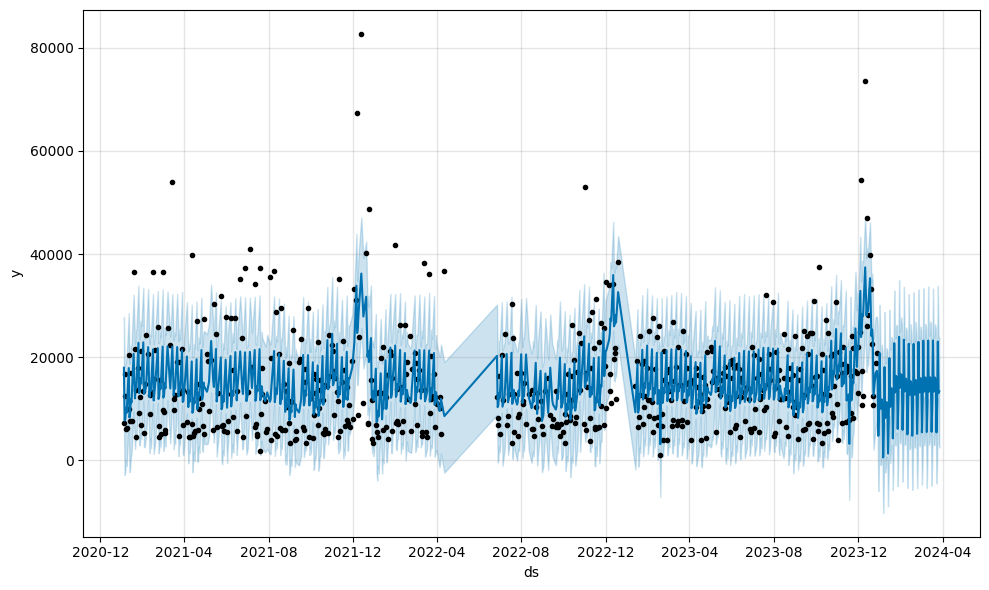

In [26]:
# Visualización de predicciones
fig = model.plot(forecast)

### **Paso 7: Descomposición de componentes de la serie temporal**

Después de visualizar las predicciones generales de la serie temporal, se analizan los componentes individuales:

- Tendencia general de la serie temporal: Se puede visualizar un descenso en la información del 2022, principalmente debido a un período donde ambos couriers no reportaron información, específicamente el mes de mayo 2022.  

- Estacionalidad semanal: se destaca el lunes como el día en que se presentan a despacho mercancías con mayor valor CIF durante la semana. 

- Estacionalidad anual de la serie temporal: se destacan picos de consumo en noviembre y diciembre, asociado a las fechas festivas. 

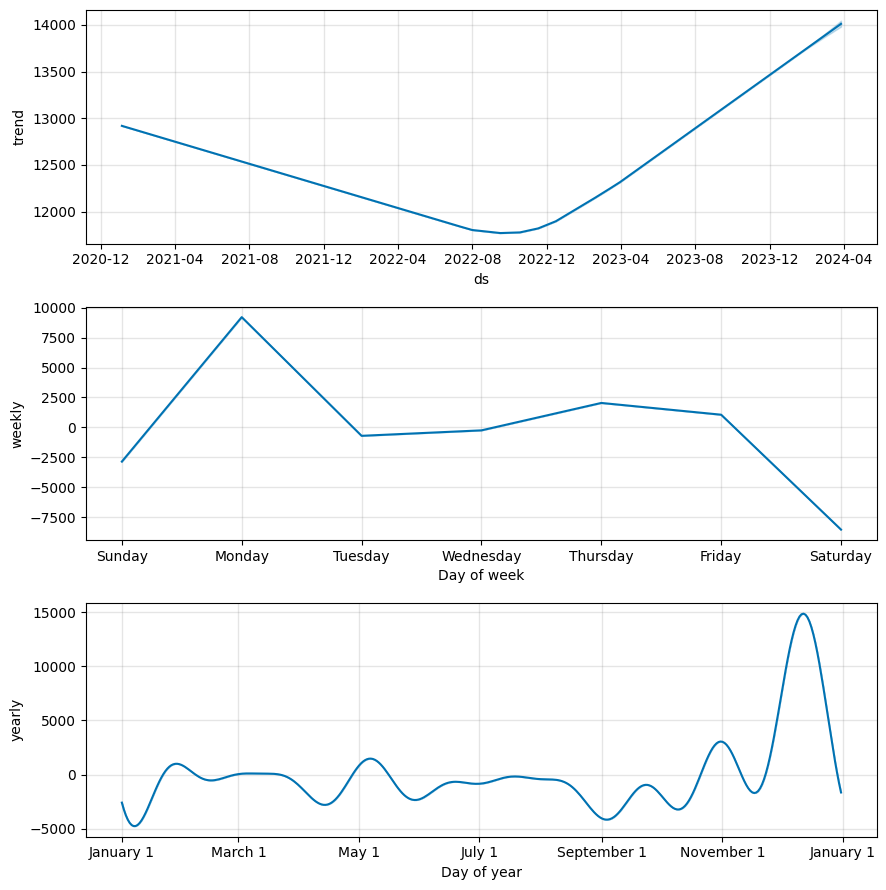

In [27]:
# Descomposición de componentes de serie temporal
# Versión estática
fig = model.plot_components(forecast)


In [28]:
# Descomposición de componentes de serie temporal
# Versión interactiva
plot_components_plotly(model, forecast)

/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.


/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.


/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.


/Users/jorgebarquero/anaconda3/envs/Enae_SeriesTemporales/lib/python3.8/site-packages/plotly/basedatatypes.py:2314: DeprecationWarning:

The append_tra

### **Paso 8: Visualización interactiva de datos**

Después de descomponer la serie temporal, se realiza una visualización interactiva a fin de explorar más a fondo las predicciones y componentes del modelo Prophet. 

Esto permite una inspección detallada, facilitando la identicación de patrones específicos, anomalías o puntos de interés en los datos.

In [29]:
# Visualización interactiva de datos
plot_plotly(model, forecast)

# Evaluation

## Evaluación del algoritmo de recomendación -- listo

### **Reglas de Asociación: Soporte vs. Confianza** -- listo

Este gráfico de dispersión ilustra la relación entre el soporte y la confianza de las reglas de asociación derivadas del análisis de datos.

Permite comprender cómo diferentes productos importados se relacionan entre sí.

- **Soporte**: Refleja la frecuencia con la que aparece una combinación de productos (antecedente y consecuente) en el dataset. Un valor más alto indica que la regla es común, representado en el eje X del gráfico.

- **Confianza**: Indica la probabilidad de encontrar el consecuente dado el antecedente. Una mayor confianza sugiere una mayor verosimilitud de la regla, mostrada en el eje Y.

- **Lift (Tamaño del punto)**: El tamaño de los puntos muestra el "lift" de cada regla, evaluando la fuerza de la asociación.

Este análisis permite identificar patrones de compra significativos y ajustar estrategias de importación. 

In [30]:
reglas['antecedents'] = reglas['antecedents'].apply(list)
reglas['consequents'] = reglas['consequents'].apply(list)

# Crear el gráfico de dispersión
fig = px.scatter(reglas, x="support", y="confidence", size="lift",
                 hover_data=['antecedents', 'consequents'],
                 size_max=60, title="Reglas de Asociación: Soporte vs. Confianza")

# Actualizar los títulos de los ejes
fig.update_xaxes(title_text='Soporte')
fig.update_yaxes(title_text='Confianza')

# Ajustar la altura del gráfico
fig.update_layout(height=800)  # Establecer la altura en 800 píxeles

# Mostrar el gráfico
if not exportar_pdf:
    # Para generación de página web
    fig.show()
else:
    # Para exportar como PDF
    image_bytes = pio.to_image(fig, format='png')
    display(Image(image_bytes)) 


### **Diagrama de red de reglas generadas** -- listo

Para facilitar el proceso de entendimiento del conjunto de reglas generadas y como los distintos códigos del sistema armonizado se relacionan entre sí, se genera un diagrama de red utilizando la librería `networkx`.

**Funcionamiento:**

El siguiente bloque de código permite entender cómo diferentes productos, clasificados bajo el Código del Sistema Armonizado, se relacionan entre sí en términos de cómo frecuentemente se compran juntos. 

1. **Crea un espacio para los productos**: se crea un espacio virtual donde cada producto, identificado por su Código del Sistema Armonizado, tiene su lugar. Esto permite visualizar las relaciones entre ellos.

2. **Identificar Relaciones**: se analizan las reglas de asociación, que son lo patrones que permiten entender cómo la compra de un producto puede influir en la compra de otro.

3. **Dibujar Conexiones**: Basándonos en estas relaciones, se dibujan líneas entre los productos que se compran juntos. La grosura de la línea indica cuán fuerte es esta relación de compra conjunta, es decir, un "lift" más alto significa una relación más fuerte.

4. **Organizar los Productos**: Los productos se organizan de manera que aquellos con relaciones más fuertes estén más cerca unos de otros. Esto permite visualizar grupos de productos que suelen ser comprados juntos, facilitando la identificación de patrones de compra.

In [31]:
# Crear un grafo
G = nx.Graph()

# Agregar nodos y aristas desde el DataFrame de reglas
for _, row in reglas.iterrows():
    antecedents = ', '.join(str(item) for item in row['antecedents'])
    consequents = ', '.join(str(item) for item in row['consequents'])
    G.add_node(antecedents, type='antecedente')
    G.add_node(consequents, type='consecuente')
    G.add_edge(antecedents, consequents, weight=row['lift'])

# Ajustar el diseño del grafo con un valor k más grande para mayor separación
pos = nx.spring_layout(G, k=0.30)  # Aumentar k para separar más los nodos

# Crear trazas de aristas
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

edge_trace = go.Scatter(x=edge_x, y=edge_y, line=dict(width=0.5, color='#888'), hoverinfo='none', mode='lines')

# Crear trazas de nodos
node_x = []
node_y = []
text = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    text.append(node)

node_trace = go.Scatter(x=node_x, y=node_y, text=text, mode='markers+text', hoverinfo='text', marker=dict(showscale=True, colorscale='YlGnBu', size=10))

# Ajustar el diseño de la figura para que sea más alta y posiblemente más ancha
fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(showlegend=False, hovermode='closest',
                                 margin=dict(b=0,l=0,r=0,t=0),
                                 xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                                 yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                                 height=800,  # Aumentar la altura para un gráfico más alto
                                 width=1400))  # Opcional: ajustar el ancho según sea necesario

# Mostrar el gráfico
if not exportar_pdf:
    # Para generación de página web
    fig.show()
else:
    # Para exportar como PDF
    image_bytes = pio.to_image(fig, format='png')
    display(Image(image_bytes))

**Descripción de códigos sobresalientes**

- **4202**: Baúles, maletas (valijas), maletines, incluidos los de aseo y los portadocumentos, portafolios (carteras de mano), cartapacios, fundas y estuches para gafas (anteojos), binoculares, cámaras fotográficas o cinematográficas, instrumentos musicales o armas y continentes similares; sacos de viaje, sacos (bolsas) aislantes para alimentos y bebidas, bolsas de aseo, mochilas, bolsos de mano (carteras), bolsas para la compra, billeteras, portamonedas, portamapas, petacas, pitilleras y bolsas para tabaco, bolsas para herramientas y para artículos de deporte, estuches para frascos y botellas, estuches para joyas, polveras, estuches para orfebrería y continentes similares, de cuero natural o regenerado, hojas de plástico, materia textil, fibra vulcanizada o cartón, o recubiertos totalmente o en su mayor parte con esas materias o papel. 

- **4901**: libros, folletos e impresos similares, incluso en hojas sueltas. 

- **9503**: Triciclos, patinetes, coches de pedal y juguetes similares con ruedas; coches y sillas de ruedas para muñecas o muñecos; muñecas o muñecos; los demás juguetes; modelos reducidos y modelos similares, para entretenimiento, incluso animados; rompecabezas de cualquier clase. 


Se pueden destacar las siguiente observaciones:

| Observación | Descripción |
|----------|----------|
| Correlación entre tipos de productos    | Nótese un posible frecuencia con la que se compran maletas o bolsos de mano (4202) junto con juguetes como maletas de juguete o carros de juguete (9503). Esto podría revelar patrones de compra que indican compras conjuntas o sugerencias de productos relacionados.      |
| Asociación entre productos complementarios.    | Observar la co-ocurrencia de productos como libros (4901) con artículos específicos de la categoría 4202, como guías de viaje. Esto revela asociaciones entre productos que los consumidores tienden a comprar juntos.      |
| Impacto de la temporada o eventos específicos.    | Denotar como los libros educativos sobre juguetes (4901) pueden influir en la compra de juguetes específicos (9503) durante ciertas épocas del año, como las festividades o eventos especiales.      | 

## Evaluación de análisis de series temporales

### Verificación de valores de predicción

Se despliegan las métricas obtenidas para la predicción de los 90 días establecidos en la serie temporal. 

Para evaluar mejor la información, se definen los valores más relevantes:

- ds: Corresponde a la fecha de la predicción.
- yhat: Valor predicho para la serie temporal.
- yhat_lower y yhat_upper: Límites inferior y superior del intervalo de confianza de las predicciones.
- trend: Componente de tendencia de la serie temporal.
- seasonal: Componente estacional de las predicciones.


In [32]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper', 'trend' ]].tail()
#forecast.tail()


,ds,yhat,yhat_lower,yhat_upper,trend
689,2024-03-23,5408.531618,-4482.411959,16686.631990,13992.817610
690,2024-03-24,11028.792346,-150.368374,22153.100316,13997.503154
691,2024-03-25,23015.240779,12069.996042,33810.942915,14002.188698
692,2024-03-26,13026.895353,3393.628964,23959.535775,14006.874241
693,2024-03-27,13384.097071,2495.077592,23846.105498,14011.559785


# Deployment